#### (CAPE, Total Totals, CIN, RH850, and VS06) for each ensemble member

- historical (1990-2020)
- near future (2030-2060)
- distant future (2070-2100)

#### Ensemble Mean
#### The difference of future senario and historical <br>
Ming Ge Dec. 2024

In [1]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
def ax_coastlines_country(ax_s):
    ax_s.coastlines(lw=1.5, resolution='110m')
    ax_s.add_feature(cfeature.STATES.with_scale('110m'), zorder=3, linewidth=1.5, edgecolor='g')
    # mask ocean 
    ax_s.add_feature(cfeature.OCEAN, facecolor='white', zorder=1) 

def plot_p10(lat, lon, data_3d, color_map, level_s, title_s):
    # Define the figure and each axis for the rows and columns
    fig, ax = plt.subplots(nrows=2,ncols=5,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(22, 6), dpi=200)

    # ax is a 2 dimensional array of `GeoAxes`.  
    # We will flatten it into a 1-D array
    ax=ax.flatten()

    # Loop over all of the members
    for nm in range(1, 11):              
        mm = ax[nm-1].contourf(lon, lat, data_3d[nm-1], 
                      cmap = color_map, extend='both',
                      levels = level_s, 
                      transform=ccrs.PlateCarree())

        # Title each subplot with the name of the model
        ax[nm-1].set_title('member ' + str(nm))
        ax[nm-1].set_extent((ds.lon.values.min(), ds.lon.values.max(), ds.lat.values.min(), ds.lat.values.max()), crs=ccrs.PlateCarree())

        ax[nm-1].coastlines()
        ax_coastlines_country(ax[nm-1])
                 
    # Adjust the location of the subplots on the page to make room for the colorbar
    fig.subplots_adjust(bottom=0.2, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.02)

    # Add a colorbar axis at the bottom of the graph
    cbar_ax = fig.add_axes([0.2, 0.16, 0.6, 0.03])

    # Draw the colorbar
    cbar=fig.colorbar(mm, cax=cbar_ax,orientation='horizontal')

    # Add a big title at the top
    plt.suptitle(title_s)
    

In [11]:
def plot_p3(lat, lon, data_3d, color_map, level_s, title_s):

    senario = ['historical', 'near future', 'distant future']
    # Define the figure and each axis for the 3 rows and 3 columns
    fig, ax = plt.subplots(nrows=1, ncols=3,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(15, 3), dpi=150)

    # Loop over all of the senarios
    for nm in range(3):              
        mm = ax[nm].contourf(lon, lat, data_3d[nm], 
                      cmap = color_map, extend='both',
                      levels = level_s, 
                      transform=ccrs.PlateCarree())

        # Title each subplot with the name of the model
        ax[nm].set_title(senario[nm])
        ax[nm].set_extent((ds.lon.values.min(), ds.lon.values.max(), ds.lat.values.min(), ds.lat.values.max()), crs=ccrs.PlateCarree())

        ax[nm].coastlines()
        ax_coastlines_country(ax[nm])
            
    # Adjust the location of the subplots on the page to make room for the colorbar
    fig.subplots_adjust(bottom=0.2, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.02)

    # Add a colorbar axis at the bottom of the graph
    cbar_ax = fig.add_axes([0.2, 0.16, 0.6, 0.03])

    # Draw the colorbar
    cbar=fig.colorbar(mm, cax=cbar_ax,orientation='horizontal')

    # Add a big title at the top
    plt.suptitle(title_s)
    


In [12]:
def plot_p2(lat, lon, data_3d, color_map, level_s, title_s):

    senario = ['near future - historical', 'distant future - historical']
    # Define the figure and each axis for the 3 rows and 3 columns
    fig, ax = plt.subplots(nrows=1, ncols=2,
                        subplot_kw={'projection': ccrs.PlateCarree()},
                        figsize=(10, 3), dpi=150)

    for nm in range(2):              
        mm = ax[nm].contourf(lon, lat, data_3d[nm], 
                      cmap = color_map, extend='both',
                      levels = level_s, 
                      transform=ccrs.PlateCarree())

        # Title each subplot with the name of the model
        ax[nm].set_title(senario[nm])
        ax[nm].set_extent((ds.lon.values.min(), ds.lon.values.max(), ds.lat.values.min(), ds.lat.values.max()), crs=ccrs.PlateCarree())

        ax[nm].coastlines()
        ax_coastlines_country(ax[nm])
            
    # Adjust the location of the subplots on the page to make room for the colorbar
    fig.subplots_adjust(bottom=0.2, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.02)

    # Add a colorbar axis at the bottom of the graph
    cbar_ax = fig.add_axes([0.2, 0.16, 0.6, 0.03])

    # Draw the colorbar
    cbar=fig.colorbar(mm, cax=cbar_ax,orientation='horizontal')

    # Add a big title at the top
    plt.suptitle(title_s)
    

In [5]:
dir_d = '/glade/campaign/mmm/c3we/mingge/QBE/'
n_mem = 10

senario = ['historical', 'near future', 'distant future']
level_1d = [np.linspace(0, 1200, 21),
           np.linspace(0, 5000, 21),
           np.linspace(0, 60, 21),
           np.linspace(10, 25, 21),
           np.linspace(30, 60, 21),
           np.linspace(30, 90, 21)]

- Historical (1990-2020) Mean

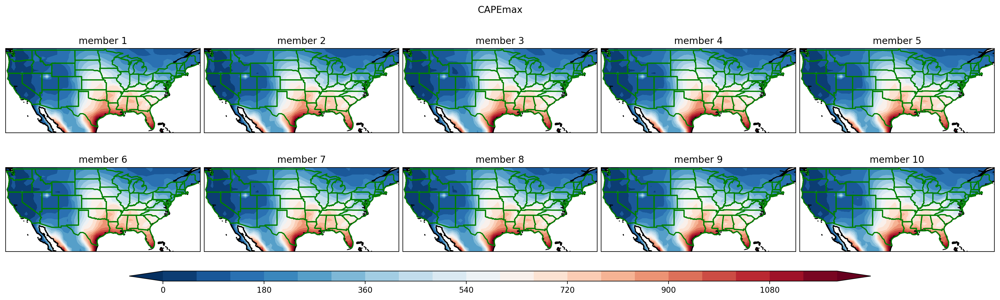

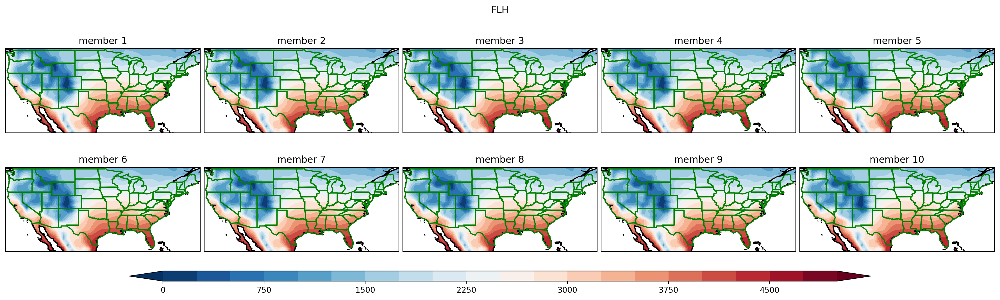

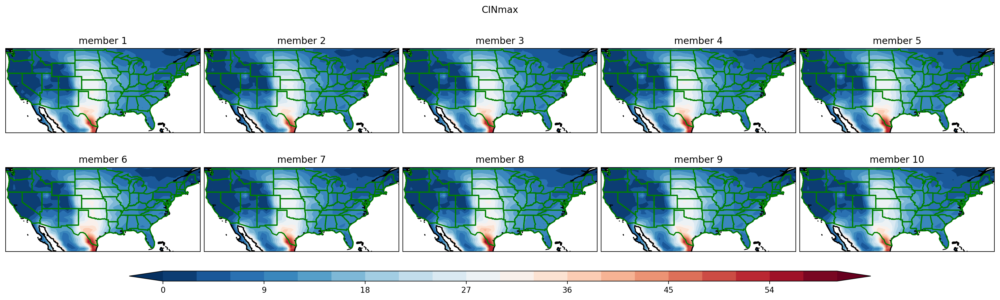

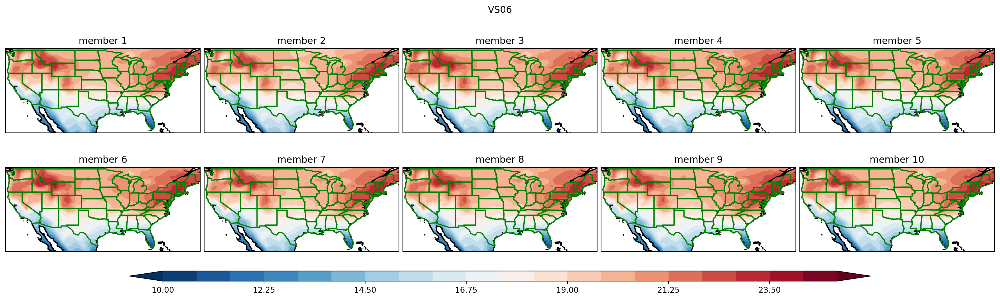

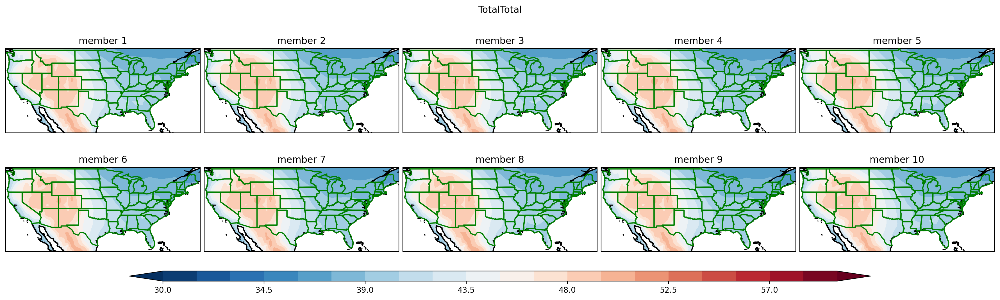

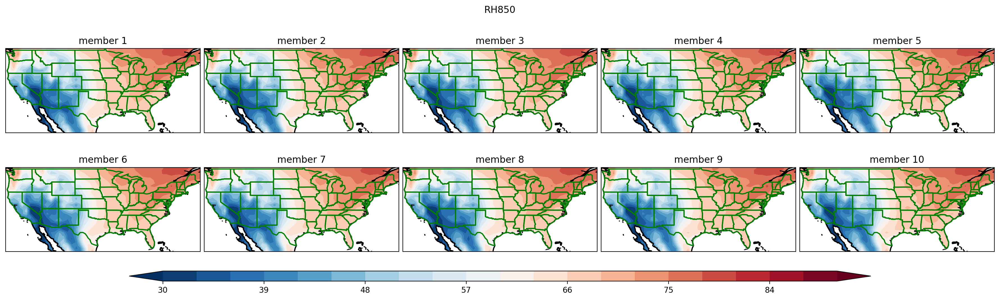

In [6]:
is_first = True
for nm in range(1, n_mem+1):
    # read data 1990-2014
    flnm = dir_d + 'hailpredictors_lens_'+str(nm).zfill(2)+'_corrected.nc'
    #print(flnm)
    with xr.open_dataset(flnm) as ds:
        data_3d = ds.hailpredictors.sel(year=slice(1990, 2014)).mean(dim=['year', 'Julian_day'])
        
        if is_first == True:
            # Add new dimension of length ensemble member by expand_dims()
            # expand_dims() makes the result read-only, so we can expand dimensions without copying the original
            # the work-around is by using .copy()
            data_4d = data_3d.expand_dims(dim={'member':n_mem}, axis=0).copy()
            data_4d_mean = data_3d.expand_dims(dim={'senario':3}, axis=0).copy()
            data_4d_mean_diff = data_3d.expand_dims(dim={'diff':2}, axis=0).copy()
            is_first = False 

        data_4d[nm-1] = data_3d*25.0/31.0
        
    #  read data from 2015-2020
    flnm = dir_d + 'hailpredictors_2015-2024lens_'+str(nm).zfill(2)+'_corrected.nc'
    #print(flnm)
    with xr.open_dataset(flnm) as ds:
        data_3d = ds.hailpredictors.sel(year=slice(2015, 2020)).mean(dim=['year', 'Julian_day'])
        data_4d[nm-1] = data_4d[nm-1] + data_3d*6.0/31.0

data_4d_mean[0] = data_4d.mean(dim='member') 

# Plotting
for nv in range(data_4d.shape[3]):
    plot_p10(ds.lat, ds.lon, data_4d[:,:,:,nv], 'RdBu_r', level_1d[nv], str(ds.variable[nv].values))

- Near future (2030-2060)

31


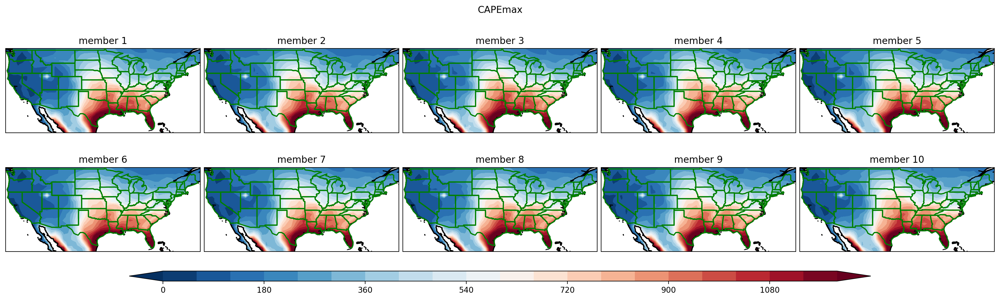

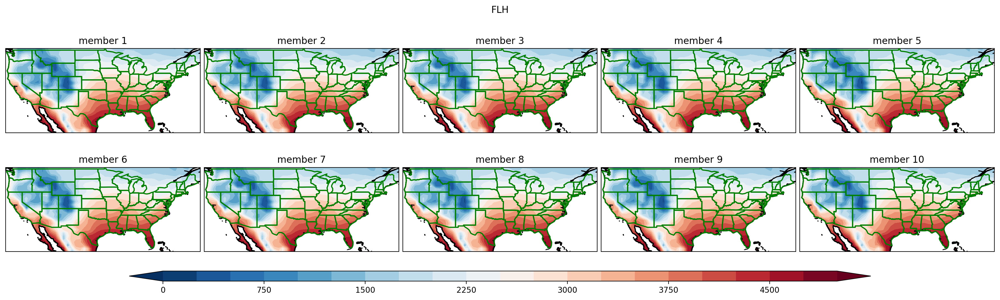

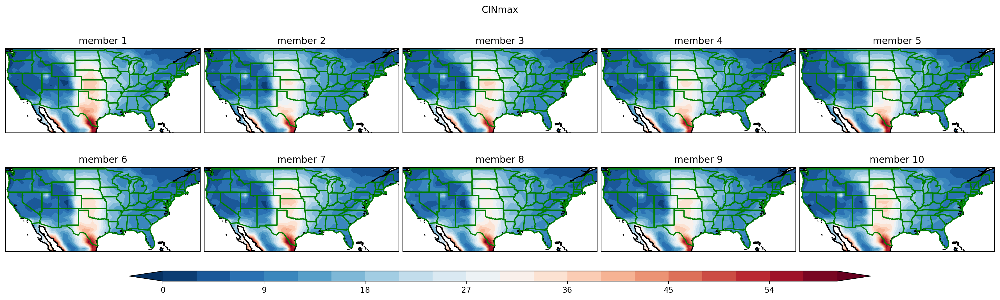

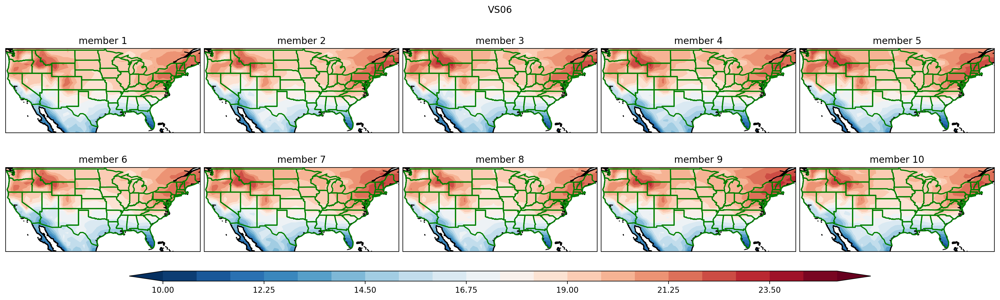

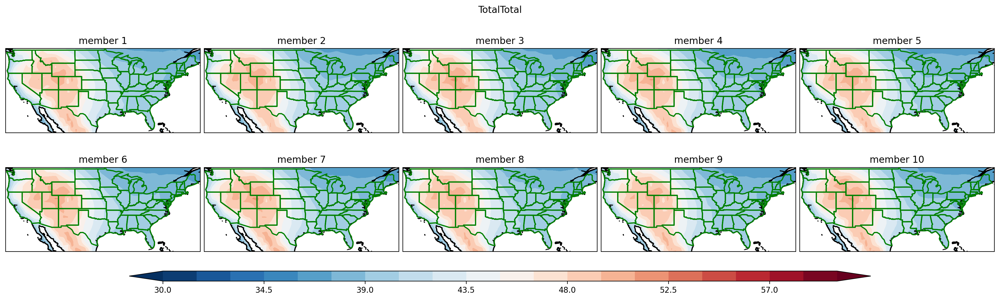

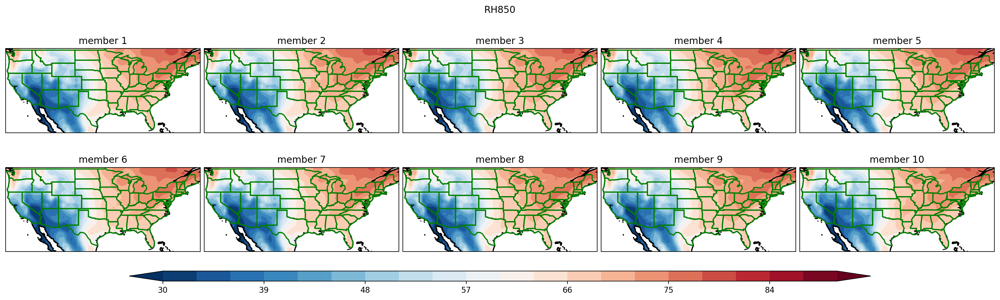

In [7]:
is_first = True

year_s_1d = [2030, 2035, 2045, 2055]
year_e_1d = [2034, 2044, 2054, 2060]

n_year = year_e_1d[-1] - year_s_1d[0] + 1
print(n_year)
 
for nm in range(1, n_mem+1):
    for nd in range(len(year_s_1d)):
        year_s = year_s_1d[nd] 
        year_e = year_e_1d[nd] 
        if year_s == year_s_1d[0]:
            year_s = year_s_1d[nd] - 5
        elif year_e == year_e_1d[-1]:
             year_e = year_e_1d[nd] + 4
        
        flnm = dir_d + 'hailpredictors_'+ str(year_s)+'-' + str(year_e)+'lens_'+str(nm).zfill(2)+'_corrected.nc'
        #print(flnm)
       
        with xr.open_dataset(flnm) as ds:
            #print(ds)
            data_3d = ds.hailpredictors.sel(year=slice(year_s_1d[nd], year_e_1d[nd])).mean(dim=['year', 'Julian_day'])
        
            if is_first == True:
                # Add new dimension of length ensemble member by expand_dims()
                # expand_dims() makes the result read-only, so we can expand dimensions without copying the original
                # the work-around is by using .copy()
                data_4d = data_3d.expand_dims(dim={'member':n_mem}, axis=0).copy() 
                data_4d[:] = 0. 
                is_first = False 
                       
        data_4d[nm-1] = data_4d[nm-1] + data_3d*(year_e_1d[nd] - year_s_1d[nd] + 1)/float(n_year)
        
data_4d_mean[1] = data_4d.mean(dim='member')     

# Plotting
for nv in range(data_4d.shape[3]):
    plot_p10(ds.lat, ds.lon, data_4d[:,:,:,nv], 'RdBu_r', level_1d[nv], str(ds.variable[nv].values))


- Distant future (2070-2100)

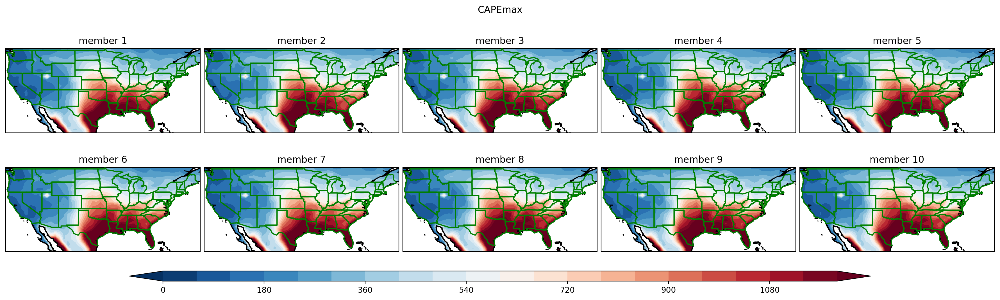

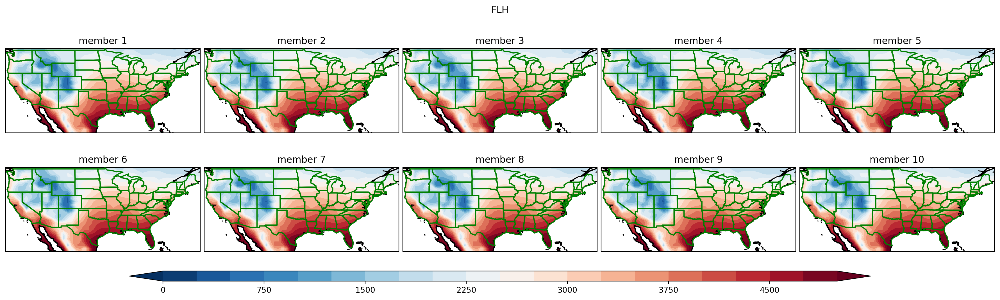

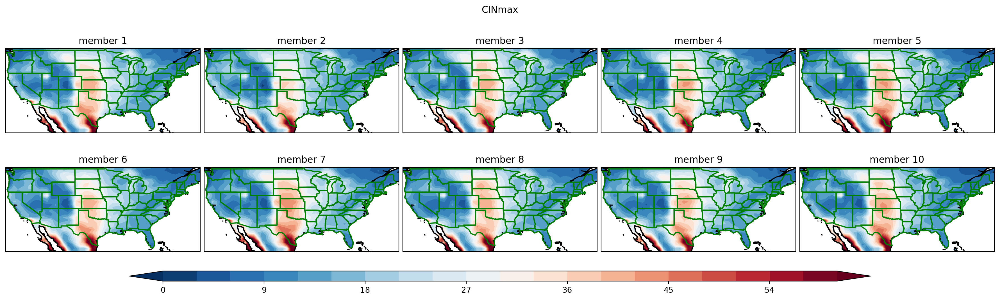

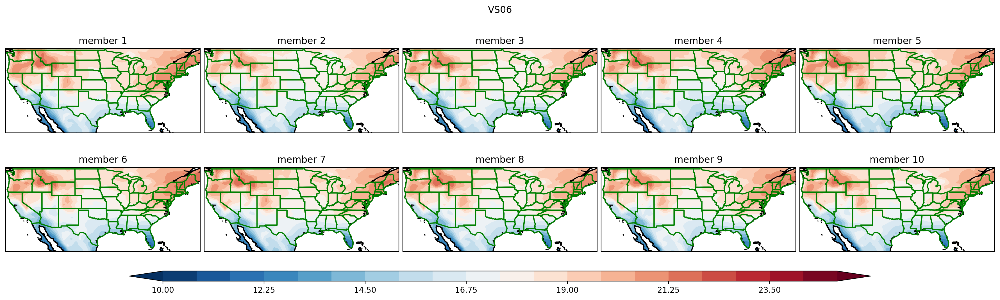

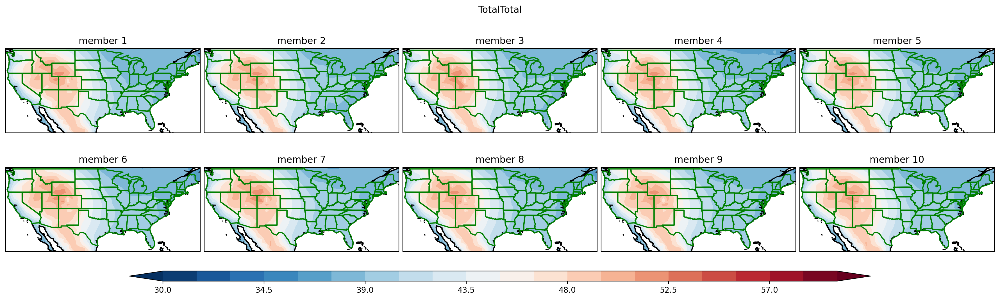

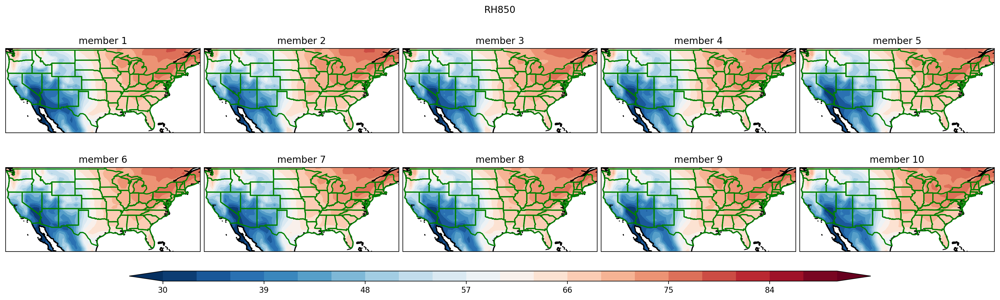

In [8]:
is_first = True

year_s_1d = [2070, 2075, 2085, 2095]
year_e_1d = [2074, 2084, 2094, 2100]

n_year = year_e_1d[-1] - year_s_1d[0] + 1
#print(n_year)
 
for nm in range(1, n_mem+1):
    for nd in range(len(year_s_1d)):
        year_s = year_s_1d[nd] 
        year_e = year_e_1d[nd] 
        if year_s == year_s_1d[0]:
            year_s = year_s_1d[nd] - 5
              
        flnm = dir_d + 'hailpredictors_'+ str(year_s)+'-' + str(year_e)+'lens_'+str(nm).zfill(2)+'_corrected.nc'
        #print(flnm)
       
        with xr.open_dataset(flnm) as ds:
            #print(ds)
            data_3d = ds.hailpredictors.sel(year=slice(year_s_1d[nd], year_e_1d[nd])).mean(dim=['year', 'Julian_day'])
        
            if is_first == True:
                # Add new dimension of length ensemble member by expand_dims()
                # expand_dims() makes the result read-only, so we can expand dimensions without copying the original
                # the work-around is by using .copy()
                data_4d = data_3d.expand_dims(dim={'member':n_mem}, axis=0).copy() 
                data_4d[:] = 0. 
                is_first = False 
               
        data_4d[nm-1] = data_4d[nm-1] + data_3d*(year_e_1d[nd] - year_s_1d[nd] + 1)/float(n_year)
        
data_4d_mean[2] = data_4d.mean(dim='member')     

# Plotting
for nv in range(data_4d.shape[3]):
    plot_p10(ds.lat, ds.lon, data_4d[:,:,:,nv], 'RdBu_r', level_1d[nv], str(ds.variable[nv].values))


#### Ensemble Mean

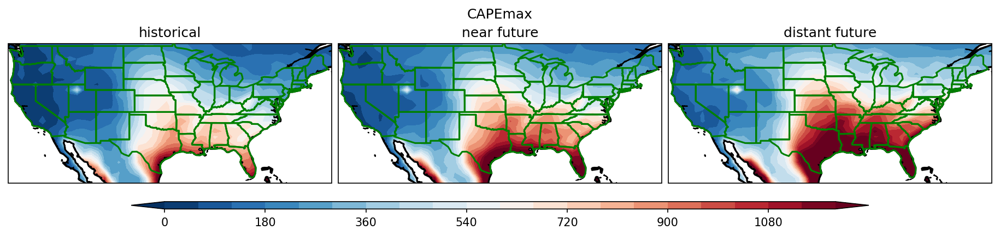

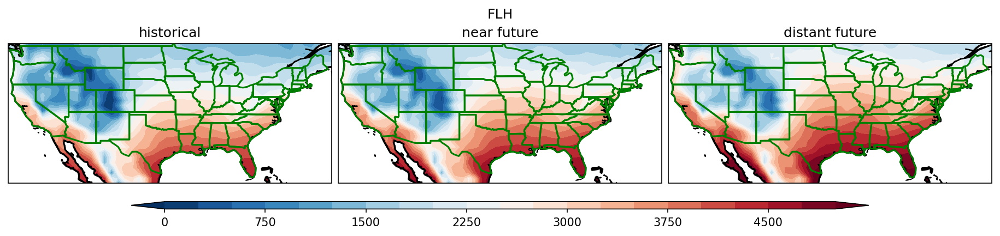

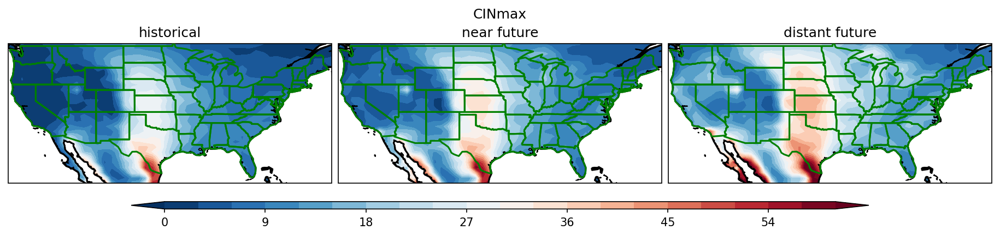

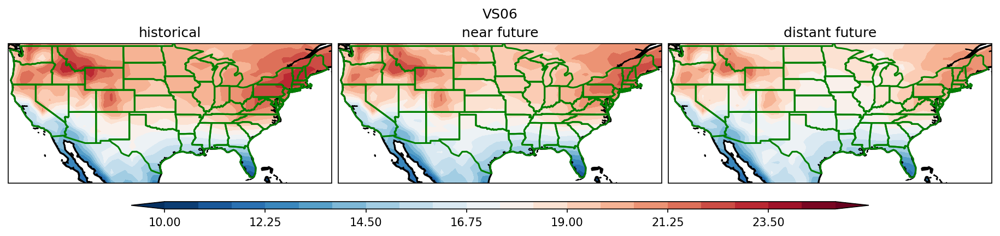

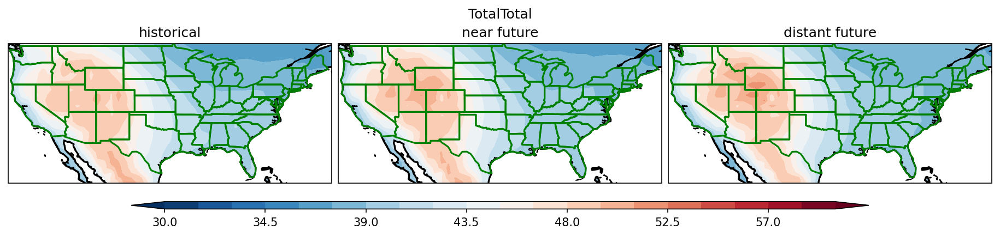

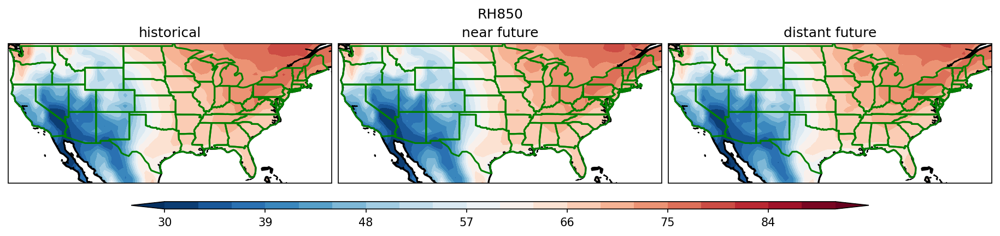

In [13]:
# Plotting
for nv in range(data_4d.shape[3]):
    plot_p3(ds.lat, ds.lon, data_4d_mean[:,:,:,nv], 'RdBu_r', level_1d[nv], str(ds.variable[nv].values))


#### The differences

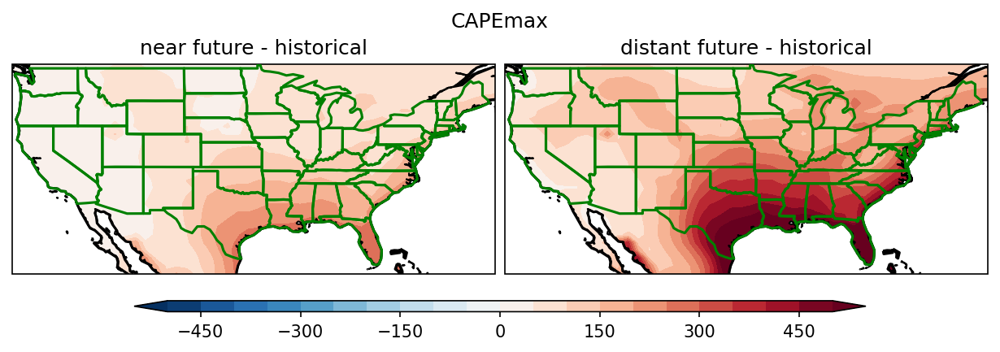

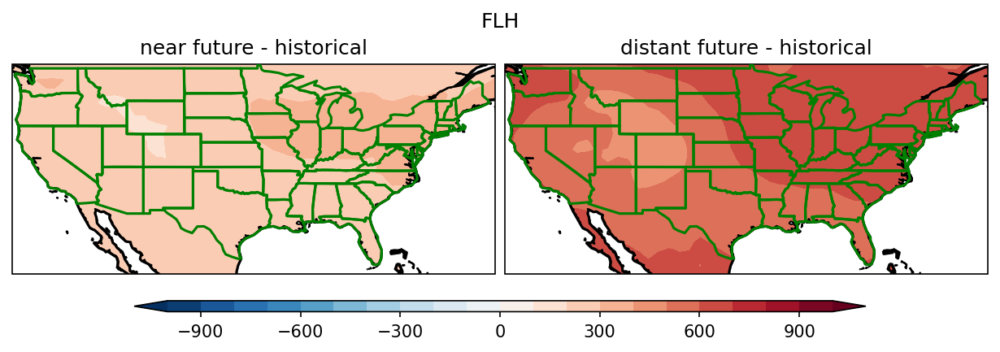

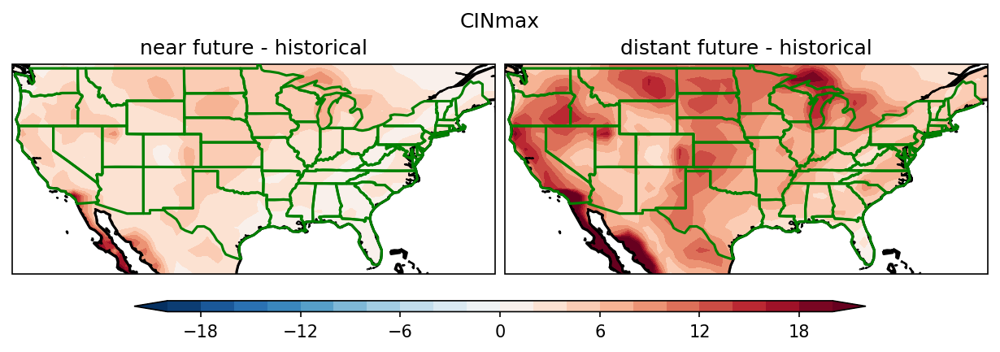

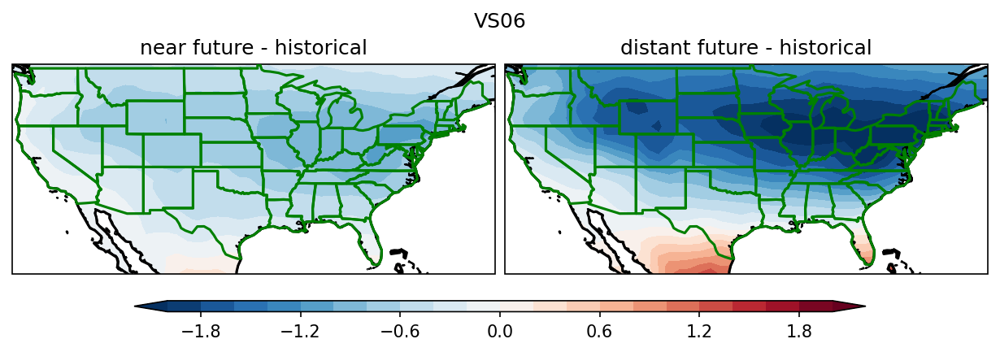

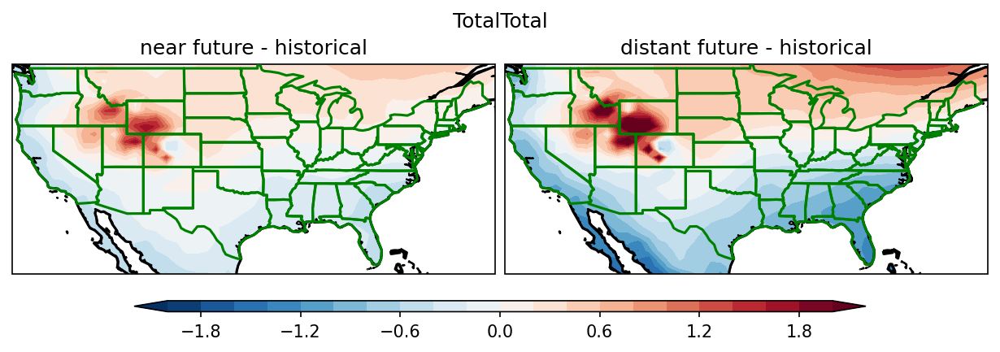

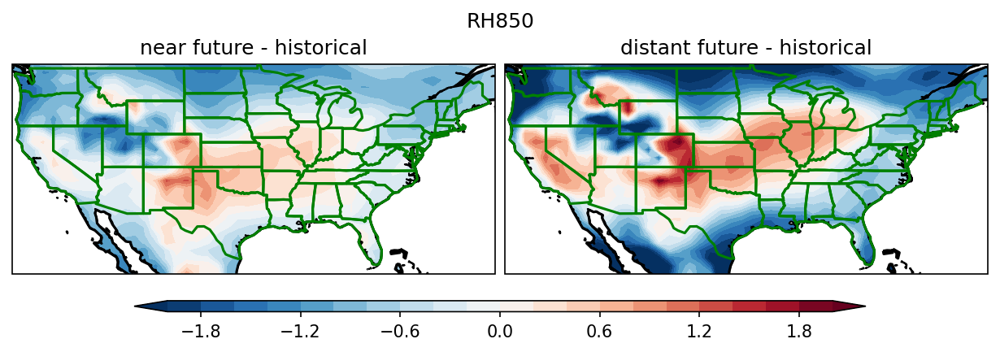

In [14]:
# Plotting
level_1d_diff = [np.linspace(-500, 500, 21),
           np.linspace(-1000, 1000, 21),
           np.linspace(-20, 20, 21),
           np.linspace(-2, 2, 21),
           np.linspace(-2, 2, 21),
           np.linspace(-2, 2, 21)]

data_4d_mean_diff[0] = data_4d_mean[1] -  data_4d_mean[0]
data_4d_mean_diff[1] = data_4d_mean[2] -  data_4d_mean[0]

for nv in range(data_4d.shape[3]):
    plot_p2(ds.lat, ds.lon, data_4d_mean_diff[:,:,:,nv], 'RdBu_r', level_1d_diff[nv], str(ds.variable[nv].values))
